In [1]:
import random
import numpy as np
import torch

def same_seeds(seed):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)
    
    torch.backends.cudnn.benchmark = False
    torch.backends.cudnn.deterministic = True

same_seeds(2021)

In [5]:
import os
import glob

import torch.nn as nn
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms
from torch import optim
from torch.autograd import Variable
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt
from qqdm.notebook import qqdm

In [6]:
class CrypkoDataset(Dataset):
    def __init__(self, fnames, transform):
        self.fnames = fnames
        self.transform = transform
        self.num_samples = len(self.fnames)
    
    def __len__(self):
        return self.num_samples
    
    def __getitem__(self, index):
        fname = self.fnames[index]
        img = torchvision.io.read_image(fname)
        img = self.transform(img)
        return img

def get_dataset(root):
    fnames = glob.glob(os.path.join(root, '*'))
    compose = [
        transforms.ToPILImage(),
        transforms.Resize((64, 64)),
        transforms.ToTensor(),
        transforms.Normalize(mean = (0.5, 0.5, 0.5), std = (0.5, 0.5, 0.5))
    ]
    transform = transforms.Compose(compose)
    dataset = CrypkoDataset(fnames, transform)
    return dataset

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


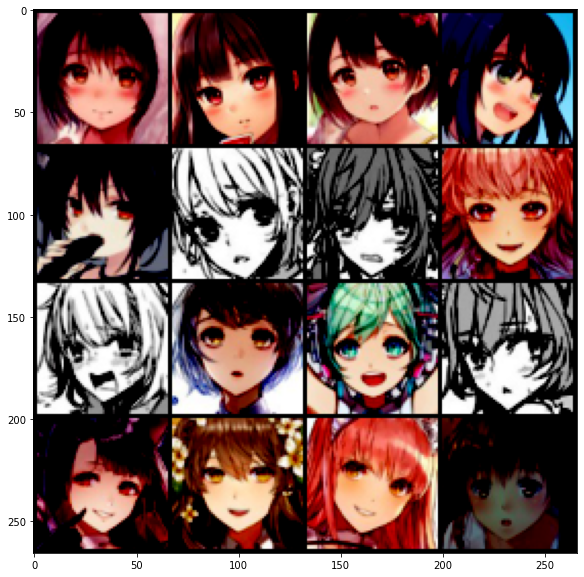

In [13]:
workspace_dir = '.'
dataset = get_dataset(os.path.join(workspace_dir, 'faces'))
images = [dataset[i] for i in range(16)]
grid_imgs = torchvision.utils.make_grid(images, nrow = 4)
plt.figure(figsize = (10, 10))
plt.imshow(grid_imgs.permute(1, 2, 0))
plt.show()

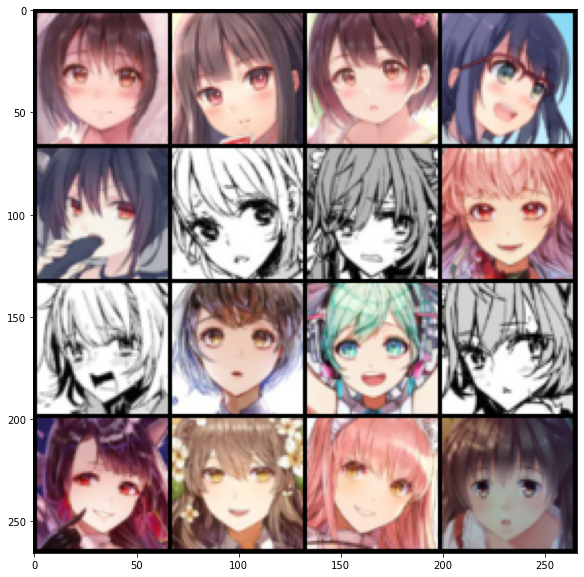

In [14]:
images = [(dataset[i] + 1) / 2 for i in range(16)]
grid_imgs = torchvision.utils.make_grid(images, nrow = 4)
plt.figure(figsize = (10, 10))
plt.imshow(grid_imgs.permute(1, 2, 0))
plt.show()

In [102]:
Tensor = torch.cuda.FloatTensor if torch.cuda.is_available() else torch.FloatTensor

def gradient_penalty(D, r_samples, f_samples):
    bs = r_samples.size(0)
    alpha = Tensor(np.random.random((bs, 1, 1, 1)))
    interpolates = (alpha * r_samples + (1 - alpha) * f_samples).requires_grad_(True)
    D_interpolates = D(interpolates)
    fake = Variable(Tensor(bs).fill_(1.0), requires_grad = False)
    gradients = torch.autograd.grad(
        inputs = interpolates,
        outputs = D_interpolates,
        grad_outputs = fake,
        create_graph = True,
        retain_graph = True,
        only_inputs = True
    )[0]
    gradients = gradients.view(gradients.size(0), -1)
    gp = ((gradients.norm(2, dim = 1) - 1) ** 2).mean()
    return gp

In [117]:
import torch
from torch.optim.optimizer import Optimizer, required

from torch.autograd import Variable
import torch.nn.functional as F
from torch import nn
from torch import Tensor
from torch.nn import Parameter

def l2normalize(v, eps=1e-12):
    return v / (v.norm() + eps)


class SpectralNorm(nn.Module):
    def __init__(self, module, name='weight', power_iterations=1):
        super(SpectralNorm, self).__init__()
        self.module = module
        self.name = name
        self.power_iterations = power_iterations
        if not self._made_params():
            self._make_params()

    def _update_u_v(self):
        u = getattr(self.module, self.name + "_u")
        v = getattr(self.module, self.name + "_v")
        w = getattr(self.module, self.name + "_bar")

        height = w.data.shape[0]
        for _ in range(self.power_iterations):
            v.data = l2normalize(torch.mv(torch.t(w.view(height,-1).data), u.data))
            u.data = l2normalize(torch.mv(w.view(height,-1).data, v.data))

        # sigma = torch.dot(u.data, torch.mv(w.view(height,-1).data, v.data))
        sigma = u.dot(w.view(height, -1).mv(v))
        setattr(self.module, self.name, w / sigma.expand_as(w))

    def _made_params(self):
        try:
            u = getattr(self.module, self.name + "_u")
            v = getattr(self.module, self.name + "_v")
            w = getattr(self.module, self.name + "_bar")
            return True
        except AttributeError:
            return False


    def _make_params(self):
        w = getattr(self.module, self.name)

        height = w.data.shape[0]
        width = w.view(height, -1).data.shape[1]

        u = Parameter(w.data.new(height).normal_(0, 1), requires_grad=False)
        v = Parameter(w.data.new(width).normal_(0, 1), requires_grad=False)
        u.data = l2normalize(u.data)
        v.data = l2normalize(v.data)
        w_bar = Parameter(w.data)

        del self.module._parameters[self.name]

        self.module.register_parameter(self.name + "_u", u)
        self.module.register_parameter(self.name + "_v", v)
        self.module.register_parameter(self.name + "_bar", w_bar)


    def forward(self, *args):
        self._update_u_v()
        return self.module.forward(*args)

In [118]:
def weight_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

class Generator(nn.Module):
    def __init__(self, in_dim, dim = 64):
        super(Generator, self).__init__()
        
        def dconv_bn_relu(in_dim, out_dim):
            return nn.Sequential(
                nn.ConvTranspose2d(in_dim, out_dim, 5, 2, padding = 2, output_padding = 1, bias = False),
                nn.BatchNorm2d(out_dim),
                nn.ReLU(),
            )
        
        self.l1 = nn.Sequential(
            nn.Linear(in_dim, dim * 8 * 4 * 4, bias = False),
            nn.BatchNorm1d(dim * 8 * 4 * 4),
            nn.ReLU(),
        )
        
        self.l2_5 = nn.Sequential(
            dconv_bn_relu(dim * 8, dim * 4),
            dconv_bn_relu(dim * 4, dim * 2),
            dconv_bn_relu(dim * 2, dim),
            nn.ConvTranspose2d(dim, 3, 5, 2, padding = 2, output_padding = 1),
            nn.Tanh(),
        )
        
        #self.apply(weight_init)
        
    def forward(self, x):
        y = self.l1(x)
        y = y.view(y.size(0), -1, 4, 4)
        y = self.l2_5(y)
        return y
    

class Discriminator(nn.Module):
    def __init__(self, in_dim, dim = 64):
        super(Discriminator, self).__init__()
        
        def conv_bn_lrelu(in_dim, out_dim):
            return nn.Sequential(
                # nn.Conv2d(in_dim, out_dim, 5, 2, 2),
                SpectralNorm(nn.Conv2d(in_dim, out_dim, 5, 2, 2)),
                nn.BatchNorm2d(out_dim),
                nn.LeakyReLU(0.2),
            )
        
        self.ls = nn.Sequential(
            # nn.Conv2d(in_dim, dim, 5, 2, 2),
            SpectralNorm(nn.Conv2d(in_dim, dim, 5, 2, 2)),
            nn.LeakyReLU(0.2),
            conv_bn_lrelu(dim, dim * 2),
            conv_bn_lrelu(dim * 2, dim * 4),
            conv_bn_lrelu(dim * 4, dim * 8),
            # nn.Conv2d(dim * 8, 1, 4),
            SpectralNorm(nn.Conv2d(dim * 8, 1, 4)),
        )
        
        #self.apply(weight_init)
        
    def forward(self, x):
        y = self.ls(x)
        y = y.view(-1)
        return y

In [119]:
batch_size = 64
z_dim = 100
z_samples = Variable(torch.randn(100, z_dim)).cuda()
lr = 2e-4

log_dir = os.path.join(workspace_dir, 'logs')
ckpt_dir = os.path.join(workspace_dir, 'checkpoints')
os.makedirs(log_dir, exist_ok = True)
os.makedirs(ckpt_dir, exist_ok = True)

n_epoch = 50
n_critic = 5
clip_value = 0.01
gp_lambda = 10

G = Generator(z_dim).cuda()
D = Discriminator(3).cuda()
G.train()
D.train()

criterion = nn.BCELoss()

D_opt = torch.optim.Adam(filter(lambda p: p.requires_grad, D.parameters()), lr=lr, betas=(0.0, 0.9))
G_opt = torch.optim.Adam(G.parameters(), lr=lr, betas=(0.0, 0.9))
# G_opt = optim.RMSprop(G.parameters(), lr = lr)
# D_opt = optim.RMSprop(D.parameters(), lr = lr)

scheduler_D = optim.lr_scheduler.ExponentialLR(D_opt, gamma=0.99)
scheduler_G = optim.lr_scheduler.ExponentialLR(G_opt, gamma=0.99)

dataloader = DataLoader(dataset, batch_size = batch_size, shuffle = True, num_workers = 0)

   Iters      Elapsed Time      Speed     D_Loss    G_Loss   Epoch  Step                                                
 1115/1115  00:02:16<00:00:00  8.19it/s  -161.8905  81.0344    1    1115                                                

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_001.jpg.


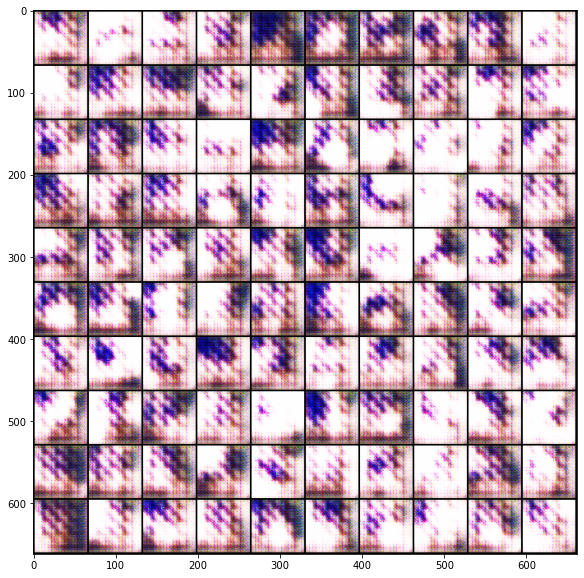

   Iters      Elapsed Time      Speed     D_Loss    G_Loss   Epoch  Step                                                
 1115/1115  00:02:14<00:00:00  8.26it/s  -197.0507  98.2777    2    2230                                                

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_002.jpg.


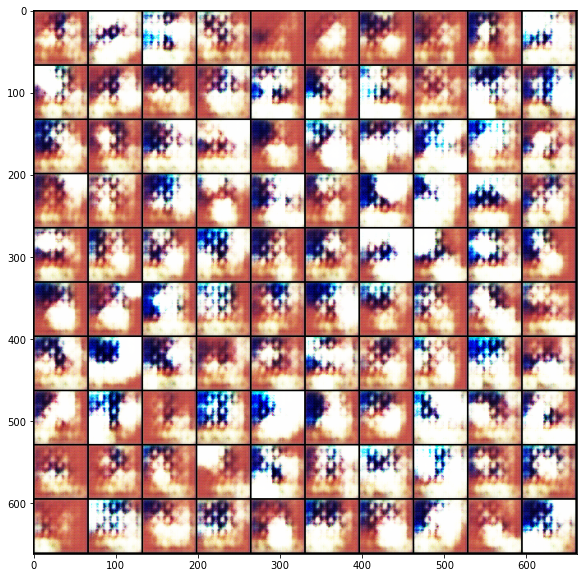

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:15<00:00:00  8.25it/s  -233.4862  116.6203    3    3345                                               

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_003.jpg.


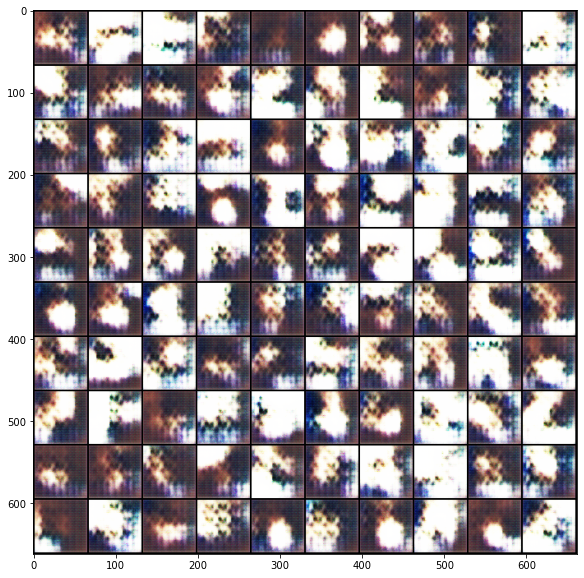

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:15<00:00:00  8.25it/s  -270.4808  135.0622    4    4460                                               

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_004.jpg.


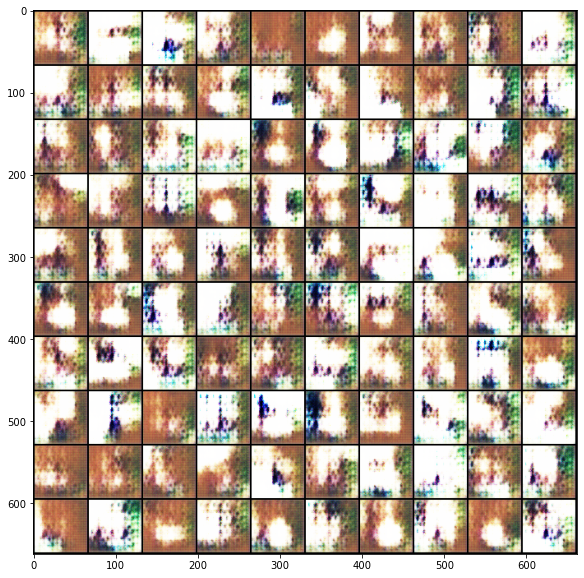

   Iters      Elapsed Time      Speed     D_Loss    G_Loss  Epoch  Step                                                 
 1115/1115  00:02:15<00:00:00  8.26it/s  -308.0236  154.06    5    5575                                                 

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_005.jpg.


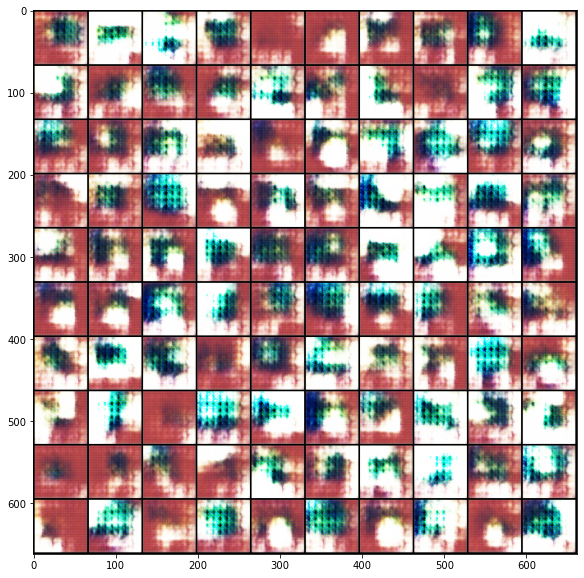

   Iters      Elapsed Time      Speed     D_Loss    G_Loss  Epoch  Step                                                 
 1115/1115  00:02:15<00:00:00  8.25it/s  -345.4984  172.72    6    6690                                                 

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_006.jpg.


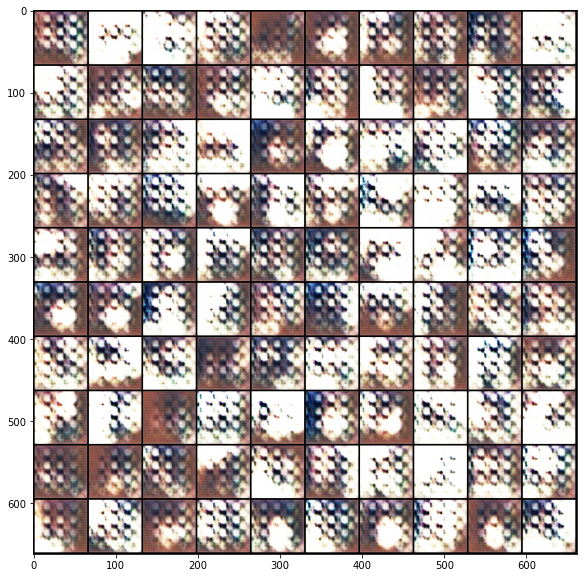

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:15<00:00:00  8.25it/s  -382.9662  191.3896    7    7805                                               

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_007.jpg.


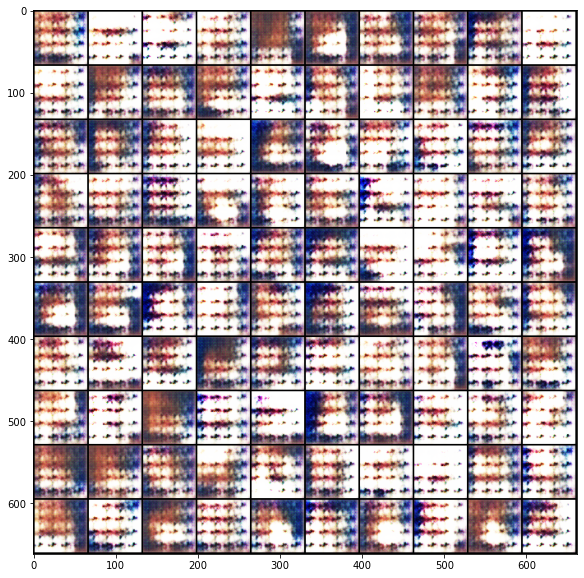

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:15<00:00:00  8.25it/s  -420.1897  209.9502    8    8920                                               

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_008.jpg.


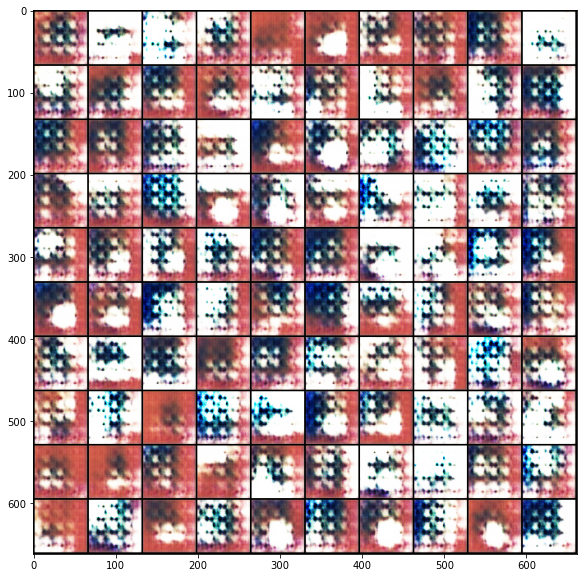

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:15<00:00:00  8.25it/s  -457.1943  228.4409    9    10035                                              

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_009.jpg.


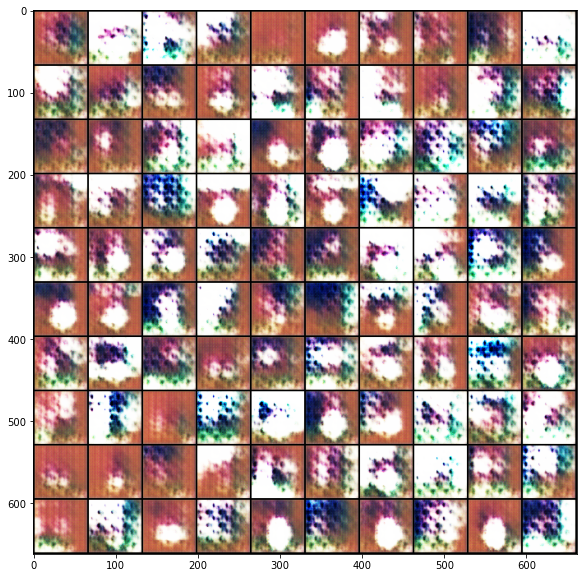

   Iters      Elapsed Time      Speed     D_Loss   G_Loss   Epoch  Step                                                 
 1115/1115  00:02:15<00:00:00  8.24it/s  -493.922  246.789   10    11150                                                

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_010.jpg.


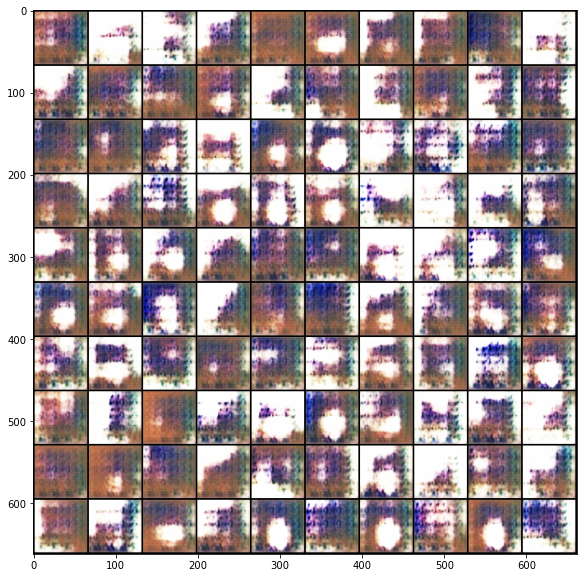

   Iters      Elapsed Time      Speed     D_Loss    G_Loss  Epoch  Step                                                 
 1115/1115  00:02:15<00:00:00  8.26it/s  -530.4128  264.86   11    12265                                                

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_011.jpg.


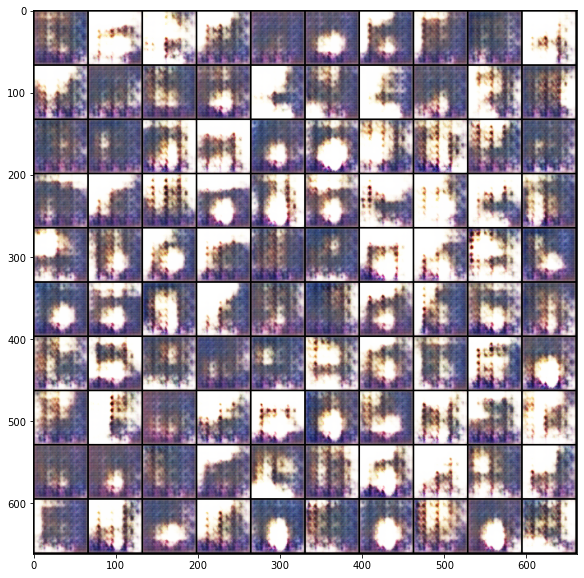

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:14<00:00:00  8.26it/s  -566.4155  282.8578   12    13380                                              

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_012.jpg.


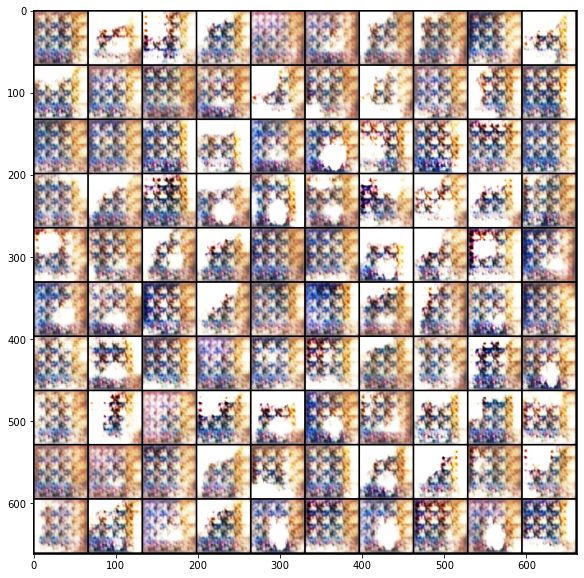

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:15<00:00:00  8.26it/s  -601.9603  300.2302   13    14495                                              

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_013.jpg.


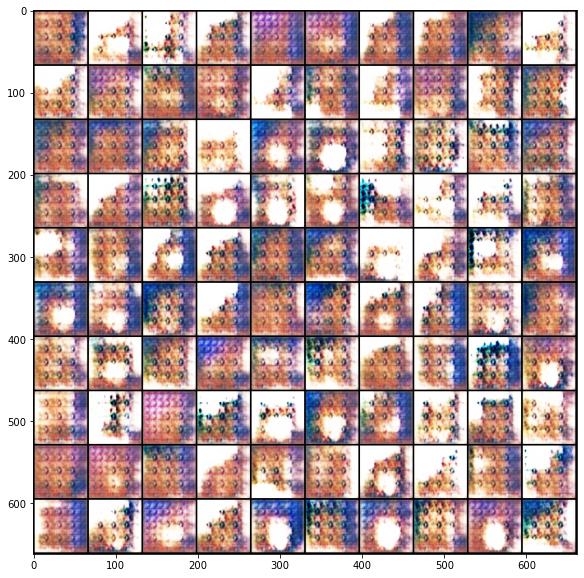

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:15<00:00:00  8.25it/s  -577.2472  318.2234   14    15610                                              

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_014.jpg.


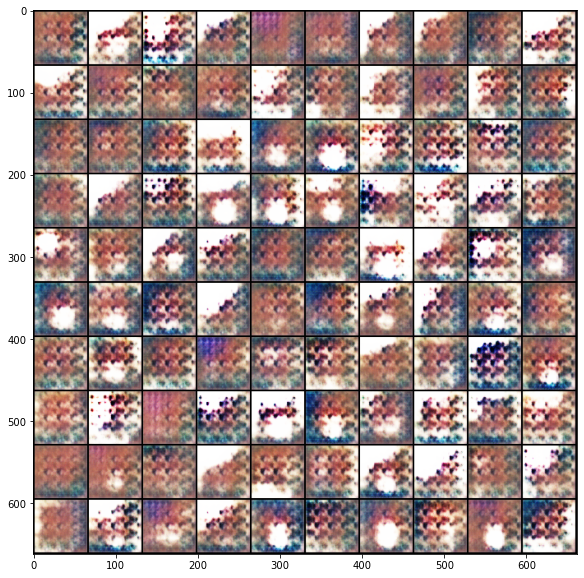

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:15<00:00:00  8.21it/s  -671.3711  335.6935   15    16725                                              

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_015.jpg.


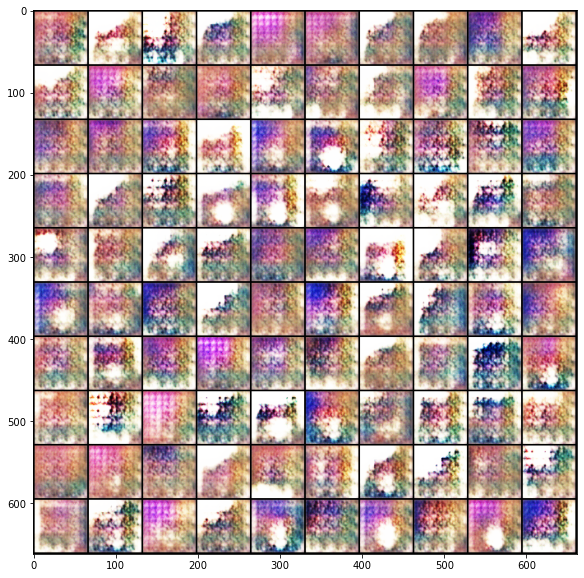

   Iters      Elapsed Time      Speed     D_Loss    G_Loss   Epoch  Step                                                
 1115/1115  00:02:15<00:00:00  8.25it/s  -707.1754  353.035   16    17840                                               

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_016.jpg.


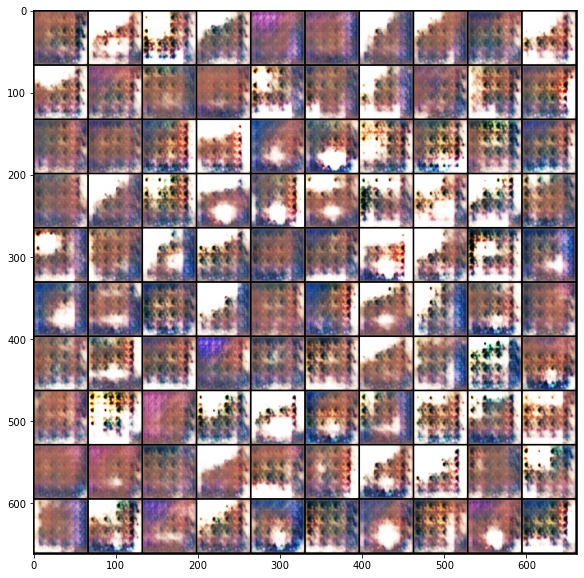

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:15<00:00:00  8.25it/s  -741.4206  370.1709   17    18955                                              

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_017.jpg.


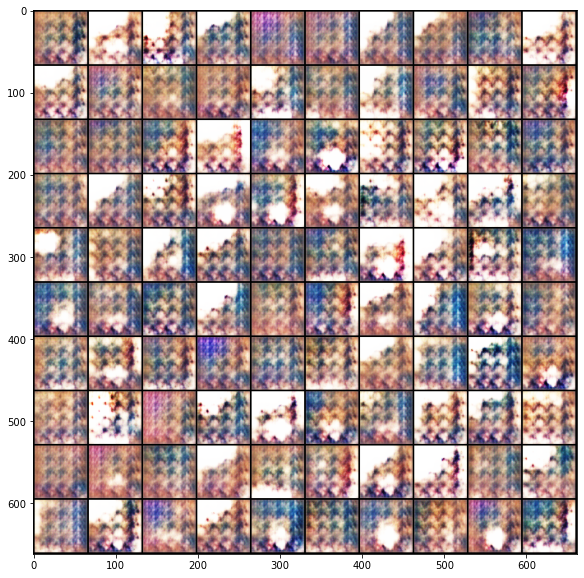

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:15<00:00:00  8.25it/s  -774.5957  387.0522   18    20070                                              

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_018.jpg.


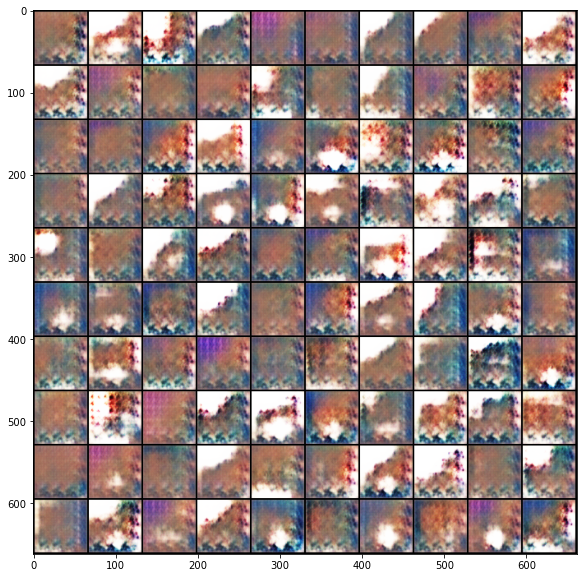

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:15<00:00:00  8.25it/s  -808.8586  403.2316   19    21185                                              

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_019.jpg.


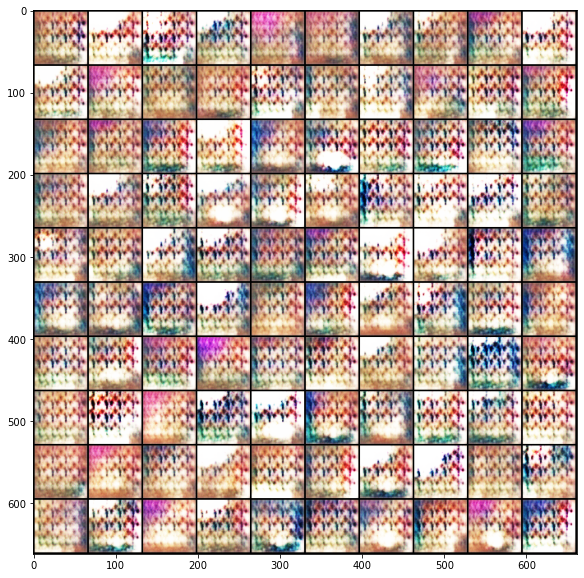

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:15<00:00:00  8.25it/s  -842.1066  420.4713   20    22300                                              

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_020.jpg.


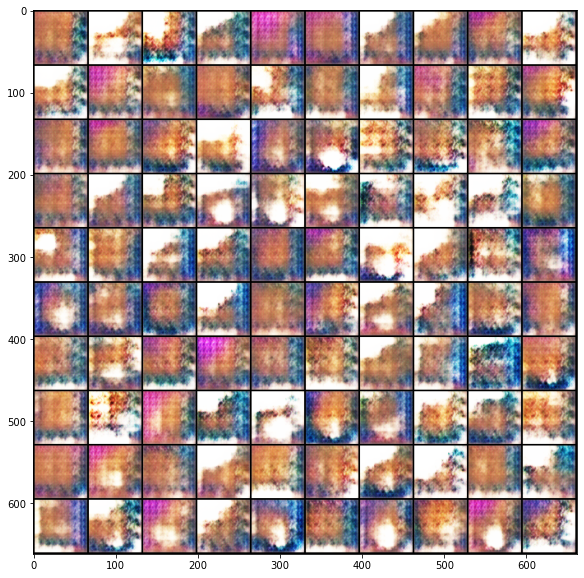

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:15<00:00:00  8.24it/s  -875.1226  436.8181   21    23415                                              

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_021.jpg.


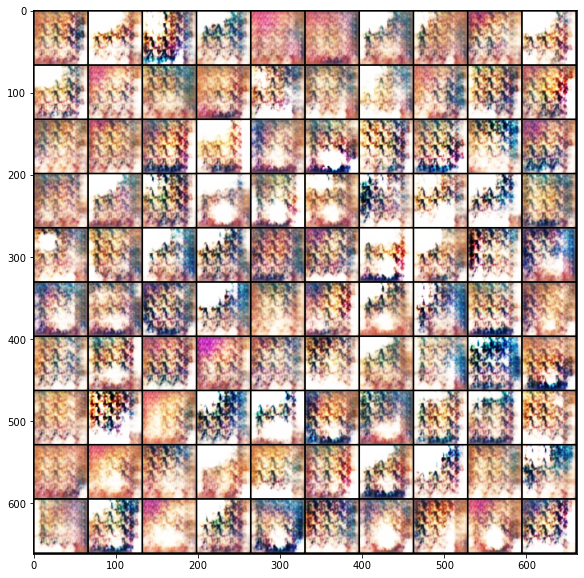

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:15<00:00:00  8.25it/s  -907.8978  453.1815   22    24530                                              

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_022.jpg.


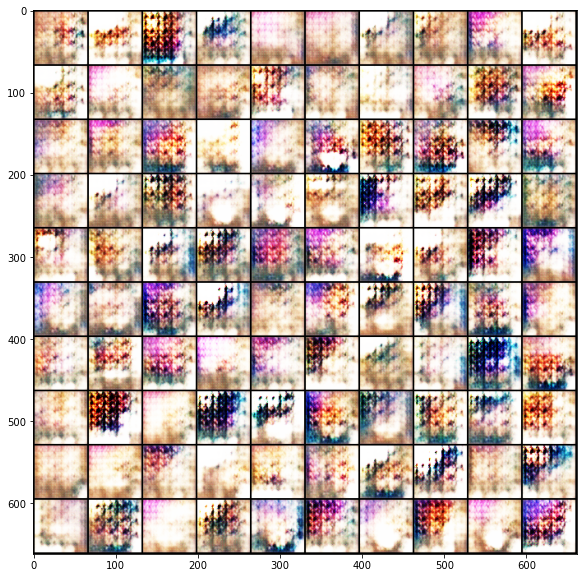

   Iters      Elapsed Time      Speed     D_Loss    G_Loss  Epoch  Step                                                 
 1115/1115  00:02:17<00:00:00  8.12it/s  -940.2275  469.46   23    25645                                                

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_023.jpg.


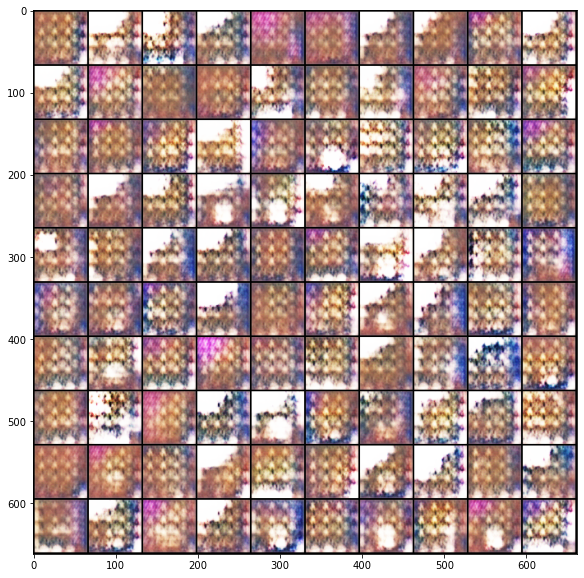

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:17<00:00:00  8.09it/s  -972.1663  485.5025   24    26760                                              

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_024.jpg.


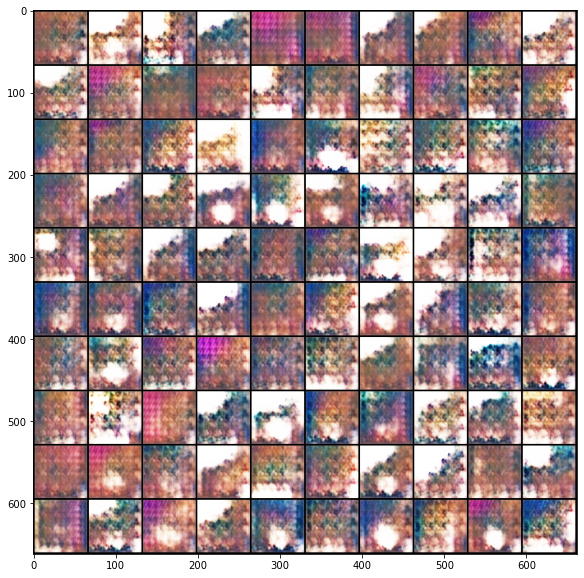

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:17<00:00:00  8.12it/s  -1002.7537  501.2941   25    27875                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_025.jpg.


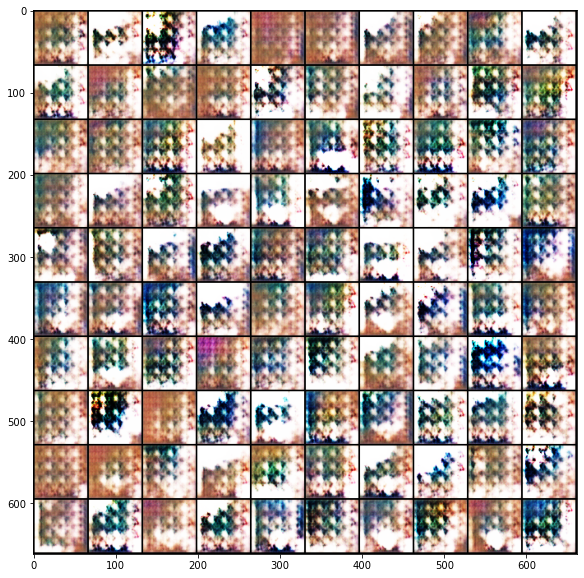

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:16<00:00:00  8.19it/s  -1035.2499  517.0469   26    28990                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_026.jpg.


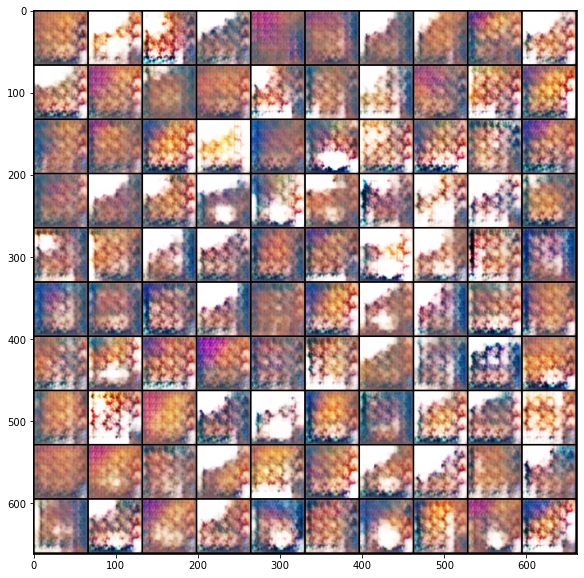

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:16<00:00:00  8.20it/s  -1066.2817  532.5133   27    30105                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_027.jpg.


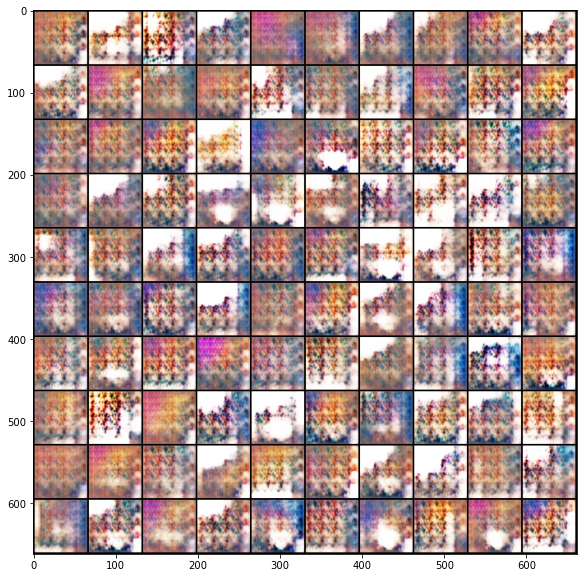

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:19<00:00:00  7.98it/s  -1096.9895  547.9173   28    31220                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_028.jpg.


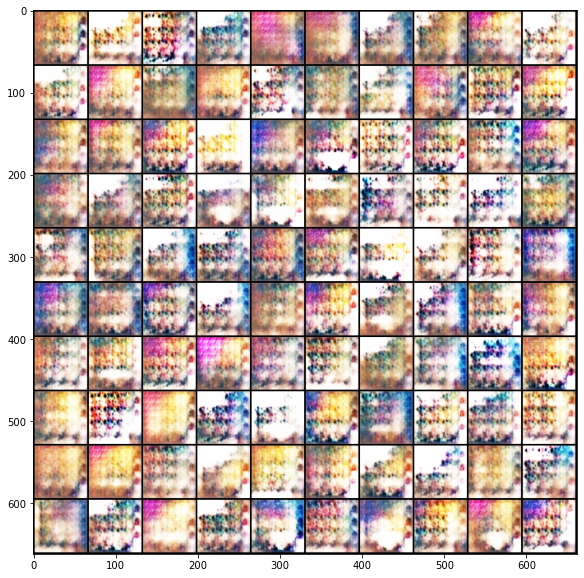

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:16<00:00:00  8.14it/s  -1127.3789  563.1162   29    32335                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_029.jpg.


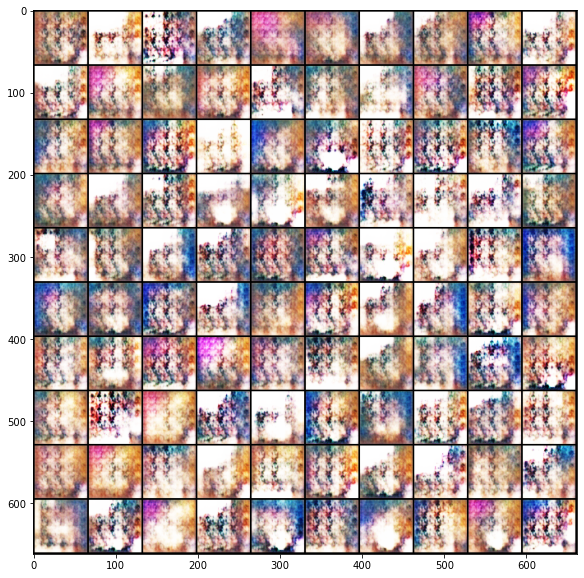

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:17<00:00:00  8.08it/s  -1156.9342  578.0869   30    33450                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_030.jpg.


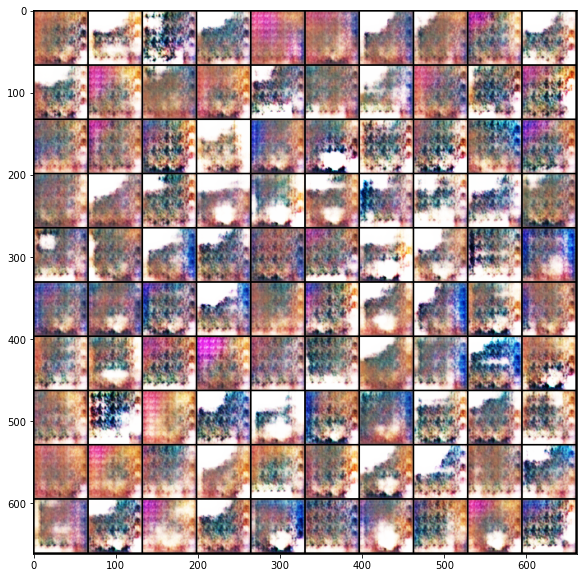

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:19<00:00:00  8.01it/s  -1187.4103  592.9988   31    34565                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_031.jpg.


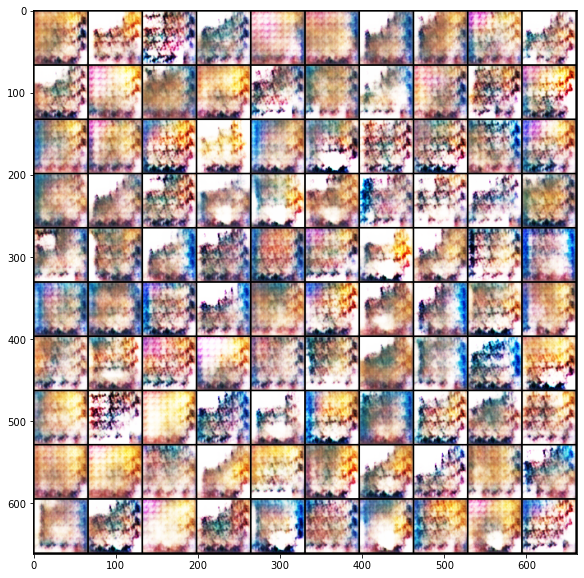

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:18<00:00:00  8.07it/s  -1216.9282  607.7646   32    35680                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_032.jpg.


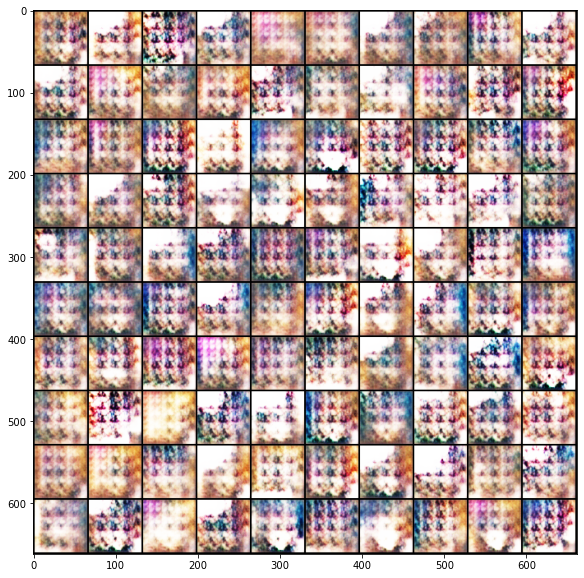

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:17<00:00:00  8.09it/s  -1246.1511  622.3896   33    36795                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_033.jpg.


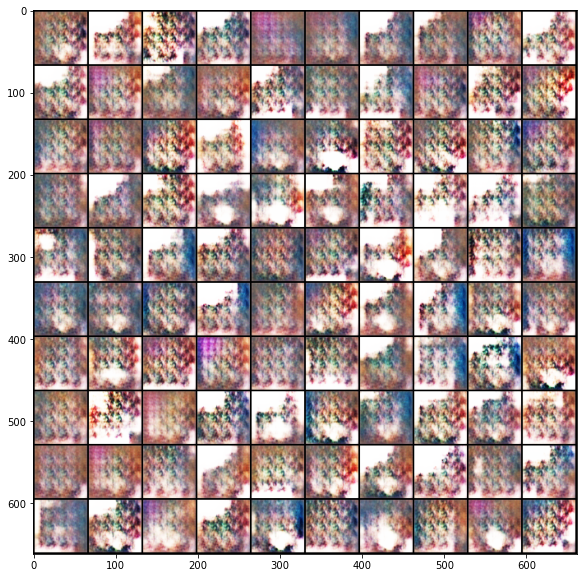

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:18<00:00:00  8.07it/s  -1274.8843  636.4689   34    37910                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_034.jpg.


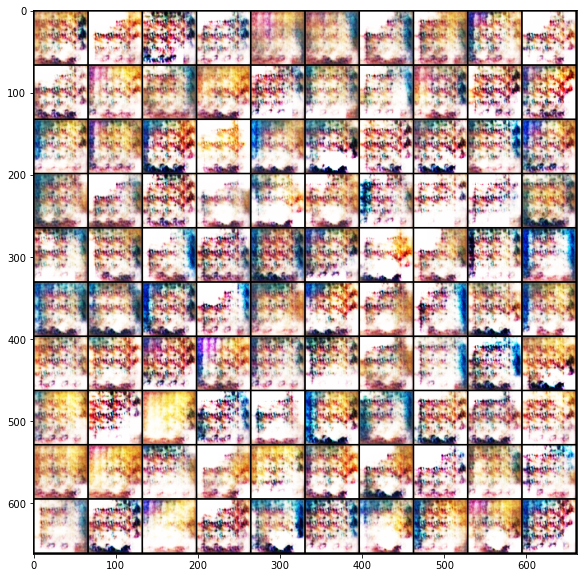

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:17<00:00:00  8.11it/s  -1303.3116  650.2394   35    39025                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_035.jpg.


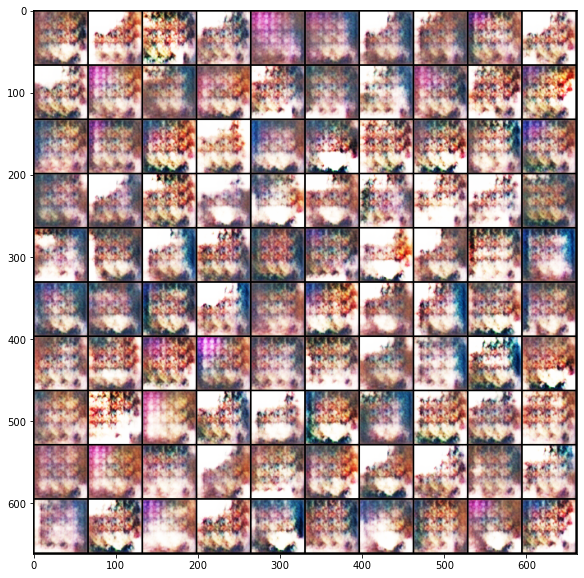

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:15<00:00:00  8.22it/s  -1331.999  665.3726   36    40140                                              

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_036.jpg.


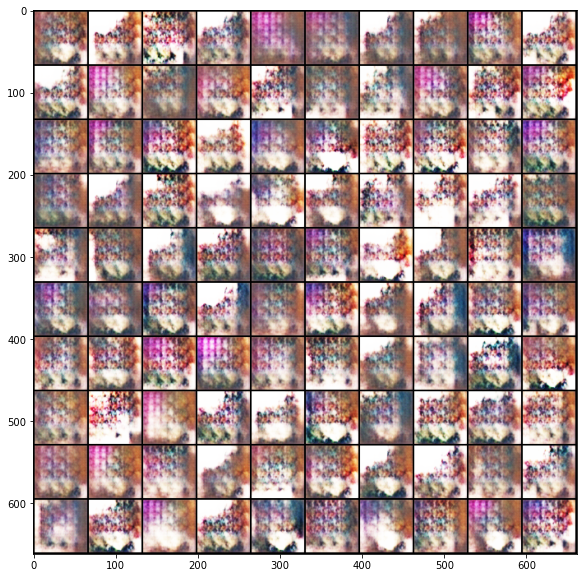

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:15<00:00:00  8.21it/s  -1360.0475  679.2941   37    41255                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_037.jpg.


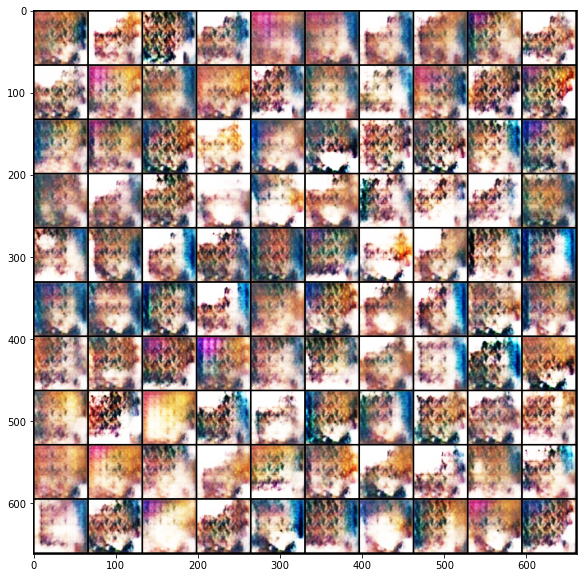

   Iters      Elapsed Time      Speed     D_Loss     G_Loss   Epoch  Step                                               
 1115/1115  00:02:16<00:00:00  8.17it/s  -519.6108  693.0622   38    42370                                              

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_038.jpg.


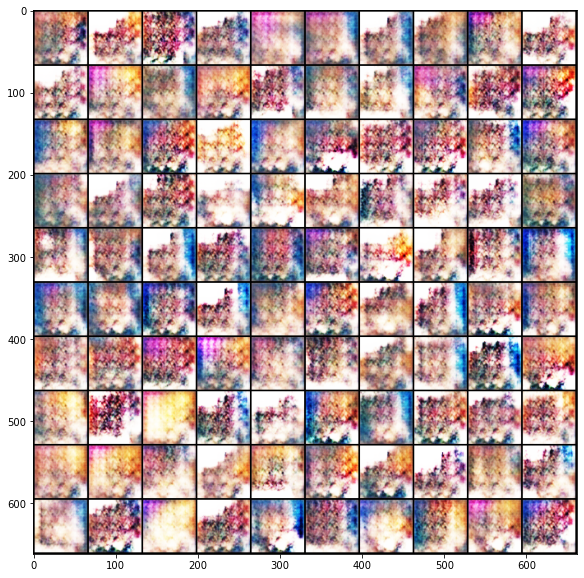

   Iters      Elapsed Time      Speed     D_Loss    G_Loss   Epoch  Step                                                
 1115/1115  00:02:15<00:00:00  8.24it/s  -1415.25  707.0139   39    43485                                               

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_039.jpg.


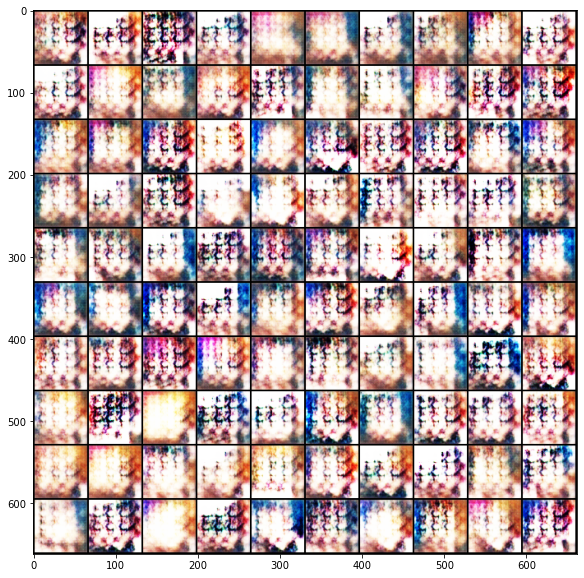

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:15<00:00:00  8.23it/s  -1442.4155  720.5679   40    44600                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_040.jpg.


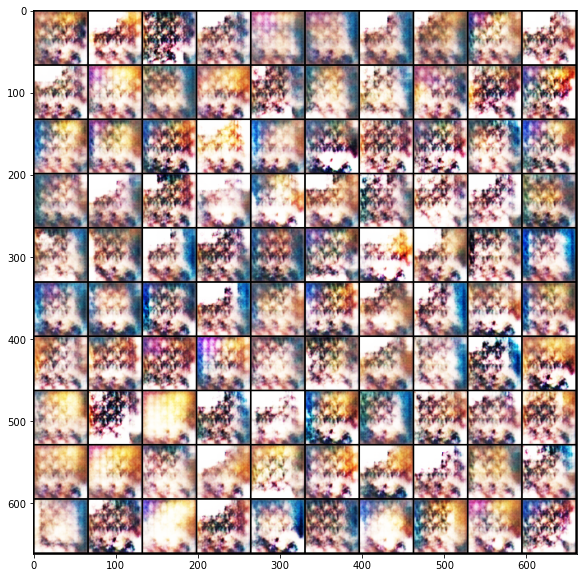

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:15<00:00:00  8.22it/s  -1468.7522  733.4821   41    45715                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_041.jpg.


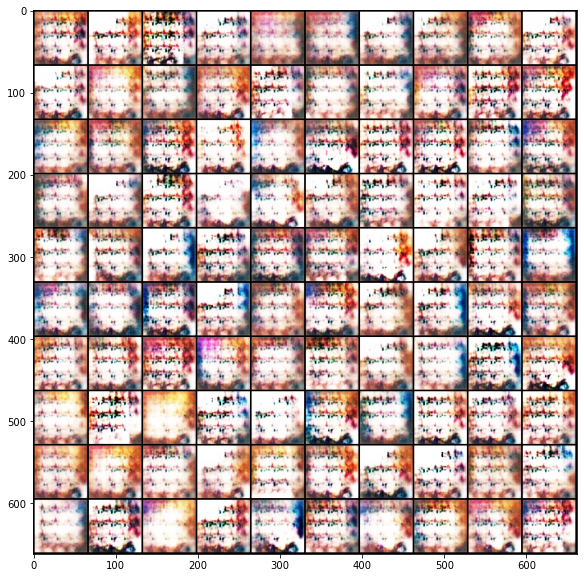

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:15<00:00:00  8.23it/s  -1493.3187  746.8235   42    46830                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_042.jpg.


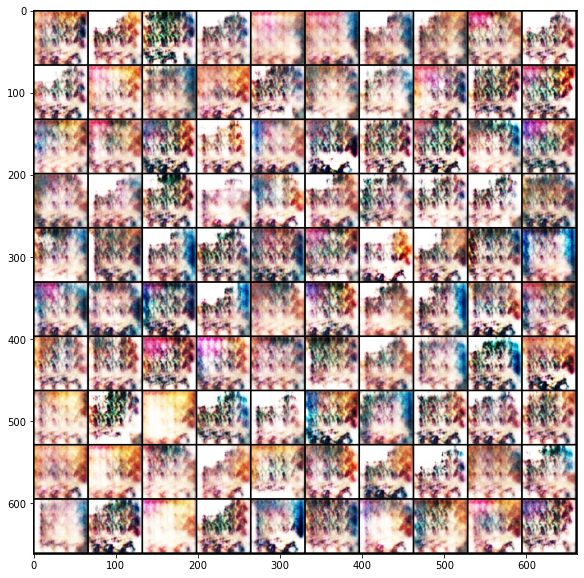

   Iters      Elapsed Time      Speed      D_Loss    G_Loss   Epoch  Step                                               
 1115/1115  00:02:15<00:00:00  8.22it/s  -1522.2444  760.505   43    47945                                              

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_043.jpg.


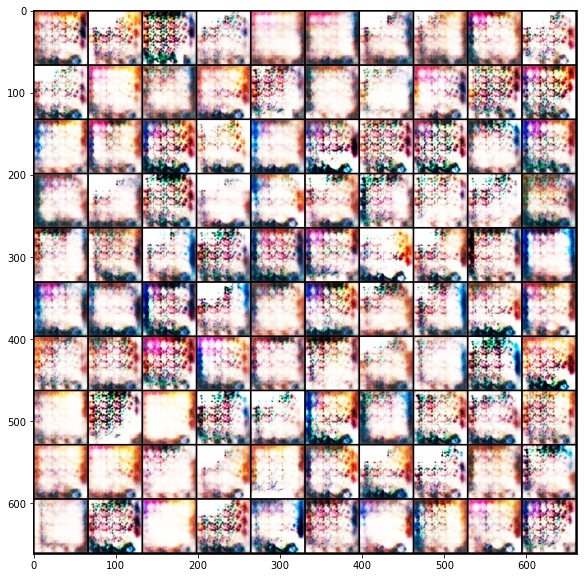

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:15<00:00:00  8.22it/s  -1545.1252  773.3365   44    49060                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_044.jpg.


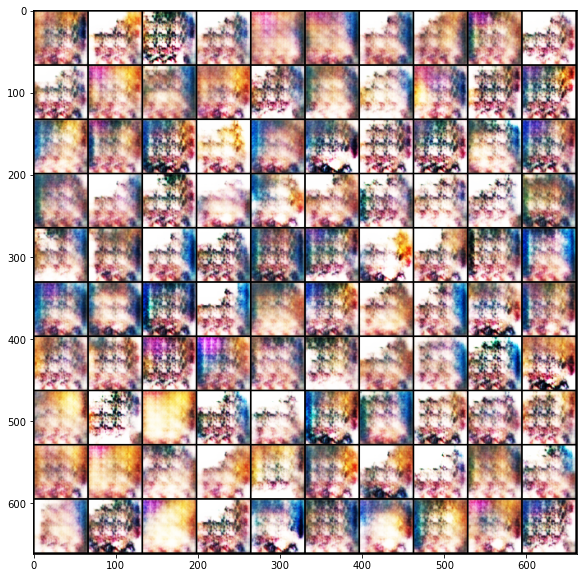

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:15<00:00:00  8.23it/s  -1573.7612  785.8751   45    50175                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_045.jpg.


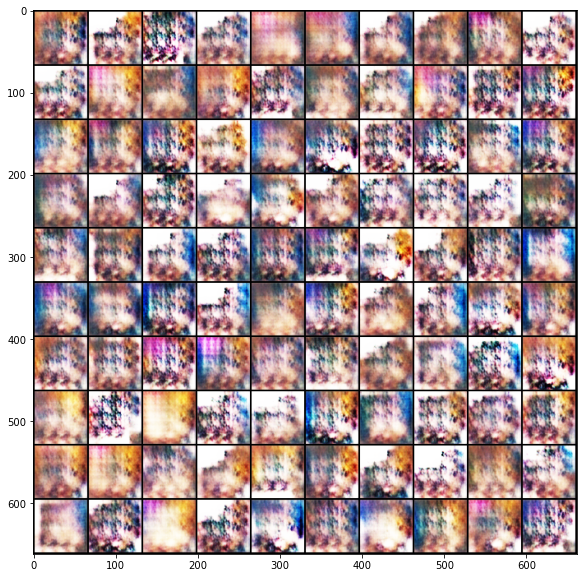

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:15<00:00:00  8.22it/s  -1599.5428  799.2398   46    51290                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_046.jpg.


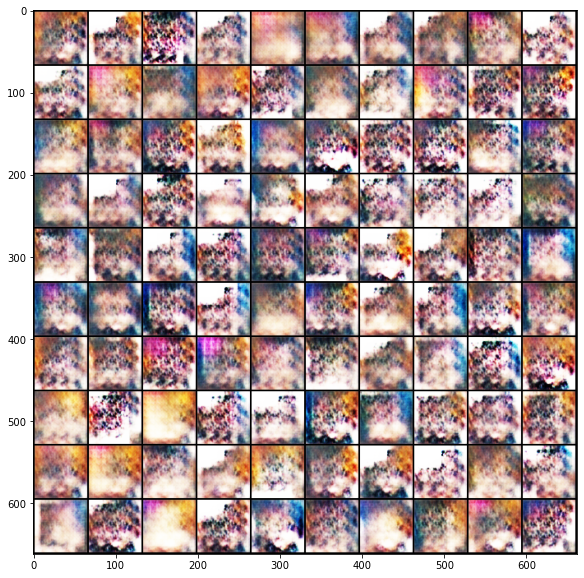

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:15<00:00:00  8.23it/s  -1624.6709  811.7551   47    52405                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_047.jpg.


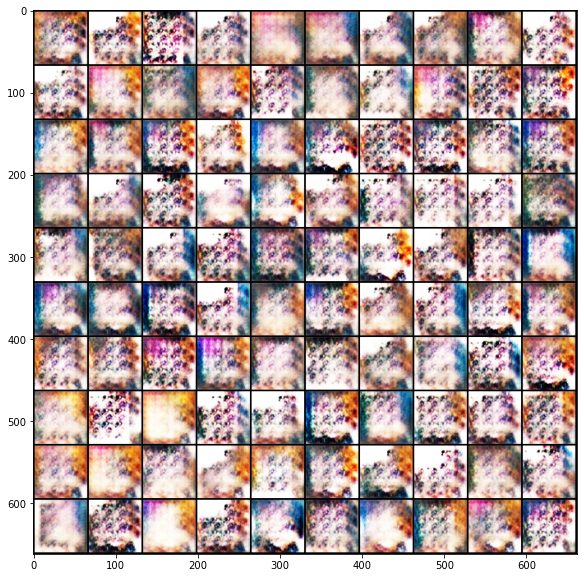

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:15<00:00:00  8.22it/s  -1649.7012  824.4062   48    53520                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_048.jpg.


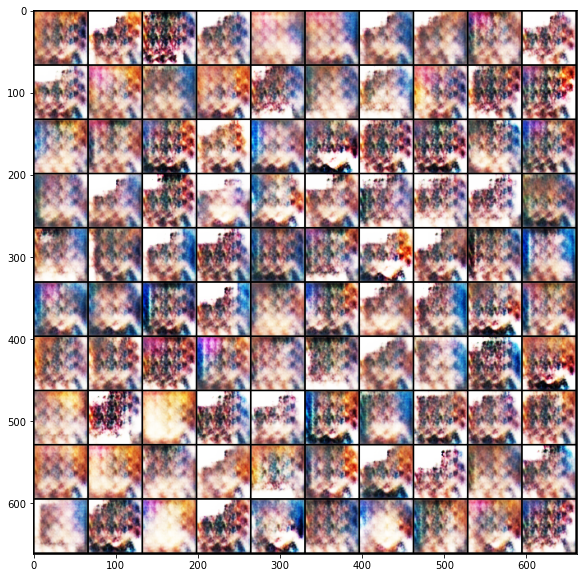

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:15<00:00:00  8.23it/s  -1674.6188  836.6383   49    54635                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_049.jpg.


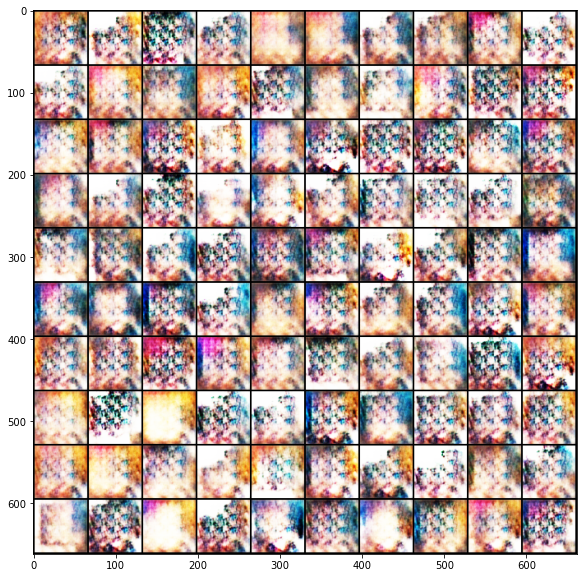

   Iters      Elapsed Time      Speed      D_Loss     G_Loss   Epoch  Step                                              
 1115/1115  00:02:16<00:00:00  8.19it/s  -1698.5828  848.8282   50    55750                                             

Widget Javascript not detected.  It may not be installed or enabled properly.


 | Save some samples to .\logs\Epoch_050.jpg.


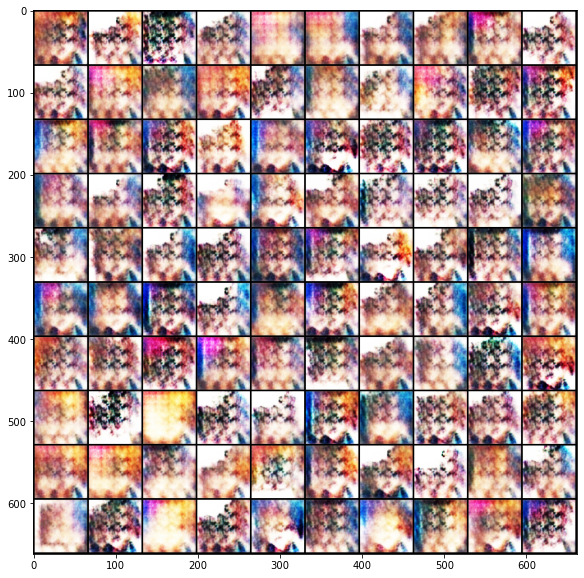

In [120]:
steps = 0
for e, epoch in enumerate(range(n_epoch)):
    progress_bar = qqdm(dataloader)
    for i, data in enumerate(progress_bar):
        imgs = data.cuda()
        bs = imgs.size(0)
        
        r_imgs = Variable(imgs).cuda()
        z = Variable(torch.randn(bs, z_dim)).cuda()
        f_imgs = G(z)
        
        r_logits = D(r_imgs.detach())
        f_logits = D(f_imgs.detach())
        
        r_labels = torch.ones((bs)).cuda()
        f_labels = torch.zeros((bs)).cuda()
        
        # r_loss = criterion(r_logits, r_labels)
        # f_loss = criterion(f_logits, f_labels)
        # D_loss = (r_loss + f_loss) / 2
        # gp = gradient_penalty(D, r_imgs.data, f_imgs.data)
        D_loss = torch.mean(f_logits) - torch.mean(r_logits)
        
        D.zero_grad()
        D_loss.backward()
        
        D_opt.step()
        
        # for p in D.parameters():
        #     p.data.clamp_(-clip_value, clip_value)
        
        if steps % n_critic == 0:
            z = Variable(torch.randn(bs, z_dim)).cuda()
            f_imgs = G(z)
            
            f_logits = D(f_imgs)
            
            # G_loss = criterion(f_logits, r_labels)
            G_loss = -torch.mean(f_logits)
            G.zero_grad()
            G_loss.backward()
            
            G_opt.step()
        
        steps += 1
        
        progress_bar.set_infos({
            'D_Loss': round(D_loss.item(), 4),
            'G_Loss': round(G_loss.item(), 4),
            'Epoch': epoch + 1,
            'Step': steps,
        })
    
    scheduler_D.step()
    scheduler_G.step()
    
    G.eval()
    f_imgs_sample = (G(z_samples).data + 1) / 2
    filename = os.path.join(log_dir, f'Epoch_{epoch+1:03d}.jpg')
    torchvision.utils.save_image(f_imgs_sample, filename, nrow = 10)
    print(f' | Save some samples to {filename}.')
    G.train()
    
    grid_imgs = torchvision.utils.make_grid(f_imgs_sample.cpu(), nrow = 10)
    plt.figure(figsize=(10, 10))
    plt.imshow(grid_imgs.permute(1, 2, 0))
    plt.show()
    
    if (e + 1) % 5 == 0 or e == 0:
        torch.save(G.state_dict(), os.path.join(ckpt_dir, 'G.pth'))
        torch.save(D.state_dict(), os.path.join(ckpt_dir, 'D.pth'))


In [121]:
G = Generator(z_dim).cuda()
G.load_state_dict(torch.load(os.path.join(ckpt_dir, 'G.pth')))
G.eval()

Generator(
  (l1): Sequential(
    (0): Linear(in_features=100, out_features=8192, bias=False)
    (1): BatchNorm1d(8192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (l2_5): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (1): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (2): Sequential(
      (0): ConvTranspose2d(128, 64, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()


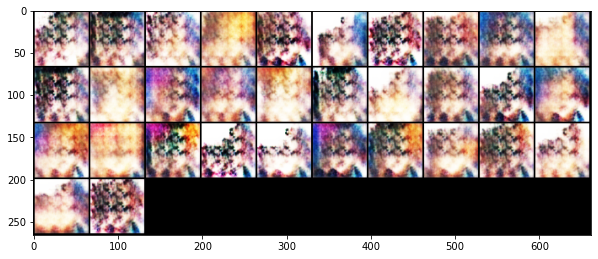

In [122]:
n_output = 300
z_sample = Variable(torch.randn(n_output, z_dim)).cuda()
sample_imgs = (G(z_sample).data + 1) / 2
filename = os.path.join(log_dir, 'result.jpg')
torchvision.utils.save_image(sample_imgs, filename, nrow = 10)

grid_sample_imgs = torchvision.utils.make_grid(sample_imgs[:32].cpu(), nrow = 10)
plt.figure(figsize = (10, 10))
plt.imshow(grid_sample_imgs.permute(1, 2, 0))
plt.show()

In [123]:
result_dir = os.path.join(workspace_dir, 'result')
os.makedirs(result_dir, exist_ok = True)
for i in range(n_output):
    torchvision.utils.save_image(sample_imgs[i], os.path.join(result_dir, f'{i+1:03d}.jpg'))